In [1152]:
import warnings
warnings.filterwarnings("ignore")

In [1153]:
import sys
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
from sklearn.pipeline import make_pipeline
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_absolute_error,mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_absolute_error,mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns
import copy

import re
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize
nltk.download('punkt')
from nltk.corpus import wordnet
import string
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
from bs4 import BeautifulSoup
from textblob import TextBlob
from unidecode import unidecode
import contractions

# magic function matplotlib inline
%matplotlib inline

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [1154]:
lemmatizer = WordNetLemmatizer()

In [1155]:
data = pd.read_csv("./superheroes/superheroes_nlp_dataset.csv")
data.head(10)

,name,real_name,full_name,overall_score,history_text,powers_text,intelligence_score,strength_score,speed_score,durability_score,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,3-D Man,"Delroy Garrett, Jr.","Delroy Garrett, Jr.",6,"Delroy Garrett, Jr. grew up to become a track ...",NaN,85,30,60,60,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,514A (Gotham),Bruce Wayne,NaN,10,He was one of the many prisoners of Indian Hil...,NaN,100,20,30,50,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,A-Bomb,Richard Milhouse Jones,Richard Milhouse Jones,20,"Richard ""Rick"" Jones was orphaned at a young ...","On rare occasions, and through unusual circu...",80,100,80,100,...,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0
3,Aa,Aa,NaN,12,Aa is one of the more passive members of the P...,NaN,80,50,55,45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Aaron Cash,Aaron Cash,Aaron Cash,5,Aaron Cash is the head of security at Arkham A...,NaN,80,10,25,40,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,Aayla Secura,Aayla Secura,NaN,8,ayla Secura was a Rutian Twi'lek Jedi Knight (...,NaN,90,40,45,55,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6,Abe Sapien,Abraham Sapien,Abraham Sapien,10,"Sapien began life as Langdon Everett Caul, a ...",Abe is a humanoid amphibious creature. He has...,95,30,35,65,...,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0
7,Abin Sur,NaN,NaN,9,Originally a history professor on the planet ...,Abin Sur possessed an exceptionally strong s...,75,90,55,65,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,Abomination,Emil Blonsky,Emil Blonsky,22,"Formerly known as Emil Blonsky, a spy of Sovie...",'Blonsky''s transformation into the Abominatio...,85,100,80,90,...,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0
9,Abra Kadabra (CW),Unknown,Unknown,13,"""Abra Kadabra"" was a criminal time traveler fr...",Abra Kadabra was augmented with various nanot...,100,10,20,30,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [1156]:
# pd.set_option('display.max_columns', None)
# pd.set_option('display.max_colwidth', -1)
# data['powers_text'].head(10)
data.shape

(1450, 81)

In [1157]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1450 entries, 0 to 1449
Data columns (total 81 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   name                              1448 non-null   object 
 1   real_name                         1301 non-null   object 
 2   full_name                         956 non-null    object 
 3   overall_score                     1450 non-null   object 
 4   history_text                      1360 non-null   object 
 5   powers_text                       1086 non-null   object 
 6   intelligence_score                1450 non-null   int64  
 7   strength_score                    1450 non-null   int64  
 8   speed_score                       1450 non-null   int64  
 9   durability_score                  1450 non-null   int64  
 10  power_score                       1450 non-null   int64  
 11  combat_score                      1450 non-null   int64  
 12  superp

### Text preprocessing

In [1158]:

# def lemmatize_pos_tagged_text(text, lemmatizer, pos_tag_dict):
#     sentences = nltk.sent_tokenize(text)
#     new_sentences = []

#     for sentence in sentences:
#         sentence = sentence.lower()
#         new_sentence_words = []
#         #one pos_tuple for sentence
#         pos_tuples = nltk.pos_tag(nltk.word_tokenize(sentence))

#     for word_idx, word in enumerate(nltk.word_tokenize(sentence)):
#         nltk_word_pos = pos_tuples[word_idx][1]
#         wordnet_word_pos = pos_tag_dict.get(
#                           nltk_word_pos[0].upper(), None)
#         if wordnet_word_pos is not None:
#             new_word = lemmatizer.lemmatize(word, wordnet_word_pos)
#         else:
#             new_word = lemmatizer.lemmatize(word)

#         new_sentence_words.append(new_word)

#     new_sentence = " ".join(new_sentence_words)
#     new_sentences.append(new_sentence)

#     return " ".join(new_sentences)

def lemmatize_pos_tagged_text(text, lemmatizer, pos_tag_dict):
  sentences = nltk.sent_tokenize(text)
  new_sentences = []

  for sentence in sentences:
    sentence = sentence.lower()
    new_sentence_words = []
    #one pos_tuple for sentence
    pos_tuples = nltk.pos_tag(nltk.word_tokenize(sentence)) 

    for word_idx, word in enumerate(nltk.word_tokenize(sentence)):
      nltk_word_pos = pos_tuples[word_idx][1]
      wordnet_word_pos = pos_tag_dict.get(
                          nltk_word_pos[0].upper(), None)
      if wordnet_word_pos is not None:
        new_word = lemmatizer.lemmatize(word, wordnet_word_pos)
      else:
        new_word = lemmatizer.lemmatize(word)

      new_sentence_words.append(new_word)

    new_sentence = " ".join(new_sentence_words)
    new_sentences.append(new_sentence)

  return " ".join(new_sentences)

def download_if_non_existent(res_path, res_name):
    try:
        nltk.data.find(res_path)
    except LookupError:
        print(f'resource {res_path} not found. Downloading now...')
        nltk.download(res_name)

class NltkPreprocessingSteps:
    def __init__(self, X):
        self.X = X
        download_if_non_existent('corpora/stopwords', 'stopwords')
        download_if_non_existent('tokenizers/punkt', 'punkt')
        download_if_non_existent('taggers/averaged_perceptron_tagger',
                                 'averaged_perceptron_tagger')
        download_if_non_existent('corpora/wordnet', 'wordnet')
        download_if_non_existent('corpora/omw-1.4', 'omw-1.4')
        self.sw_nltk = stopwords.words('english')
        new_stopwords = ['<*>']
        self.sw_nltk.extend(new_stopwords)
        self.sw_nltk.remove('not')
        self.pos_tag_dict = {"J": wordnet.ADJ,
                        "N": wordnet.NOUN,
                        "V": wordnet.VERB,
                        "R": wordnet.ADV}


        # '!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~' 32 punctuations in python
        # we dont want to replace . first time around
        self.remove_punctuations = string.punctuation.replace('.','')


    def deal_contractions(self):
        print('in remove contractions')
        self.X = self.X.apply(lambda x:contractions.fix(x))
        return self

    def remove_html_tags(self):
            print('in remove_html_tags')
            self.X = self.X.apply(
                    lambda x: BeautifulSoup(x, 'html.parser').get_text())
            return self

    def replace_diacritics(self):
            print('in replace_diacritics')
            self.X = self.X.apply(
                    lambda x: unidecode(x, errors="preserve"))
            return self
    def to_lower(self):
            print('in to_lower')
            self.X = np.apply_along_axis(lambda x: x.lower(), self.X)
            return self

    def expand_contractions(self):
            print('in expand_contractions')
            self.X = self.X.apply(
                    lambda x: " ".join([contractions.fix(expanded_word)
                                for expanded_word in x.split()]))
            return self

    def remove_numbers(self):
            print('in remove_numbers')
            self.X = self.X.apply(lambda x: re.sub(r'\d+', '', x))
            return self

    def replace_dots_with_spaces(self):
            print('in replace_dots_with_spaces')
            self.X = self.X.apply(lambda x: re.sub("[.]", " ", x))
            return self

    def remove_punctuations_except_periods(self):
            print('in remove_punctuations_except_periods')
            self.X = self.X.apply(
                         lambda x: re.sub('[%s]' %
                          re.escape(self.remove_punctuations), '' , x))
            return self

    def remove_all_punctuations(self):
            print('in remove_all_punctuations')
            self.X = self.X.apply(lambda x: re.sub('[%s]' %
                                  re.escape(string.punctuation), '' , x))
            return self

    def remove_double_spaces(self):
            print('in remove_double_spaces')
            self.X = self.X.apply(lambda x: re.sub(' +', ' ', x))
            return self

    def fix_typos(self):
#             print('in fix_typos')
#             self.X = self.X.apply(lambda x: str(TextBlob(x).correct()))
            return self

    def remove_stopwords(self):
            print('in remove_stopwords')
            # remove stop words from token list in each column
            self.X = self.X.apply(
                    lambda x: " ".join([ word for word in x.split()
                             if word not in self.sw_nltk]) )
            return self

    def lemmatize(self):
            print('in lemmatize')
            lemmatizer = WordNetLemmatizer()
            self.X = self.X.apply(lambda x: lemmatize_pos_tagged_text(
                                   x, lemmatizer, self.pos_tag_dict))
            return self

    def get_processed_text(self):
            return self.X

from sklearn.base import BaseEstimator, TransformerMixin

class NltkTextPreprocessor(TransformerMixin, BaseEstimator):
	def __init__(self):
		pass

	def fit(self, X):
		return self

	def transform(self, X):
		txt_preproc = NltkPreprocessingSteps(X.copy())
		processed_text = \
				txt_preproc \
				.deal_contractions()\
				.remove_html_tags()\
				.replace_diacritics()\
				.expand_contractions()\
				.remove_numbers()\
				.fix_typos()\
				.remove_punctuations_except_periods()\
				.lemmatize()\
				.remove_double_spaces()\
				.remove_all_punctuations()\
				.remove_stopwords()\
				.get_processed_text()

		return processed_text

In [1159]:
text_cols = data.select_dtypes(include='object').head(2)

In [1160]:
text_cols.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2 entries, 0 to 1
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   name              2 non-null      object
 1   real_name         2 non-null      object
 2   full_name         1 non-null      object
 3   overall_score     2 non-null      object
 4   history_text      2 non-null      object
 5   powers_text       0 non-null      object
 6   superpowers       2 non-null      object
 7   alter_egos        2 non-null      object
 8   aliases           2 non-null      object
 9   place_of_birth    0 non-null      object
 10  first_appearance  0 non-null      object
 11  creator           2 non-null      object
 12  alignment         1 non-null      object
 13  occupation        0 non-null      object
 14  base              0 non-null      object
 15  teams             2 non-null      object
 16  relatives         1 non-null      object
 17  gender            1 

In [1161]:
object_cols = list(text_cols.columns)
object_cols.remove('overall_score')
object_cols.remove('teams')
object_cols.remove('relatives')

In [1162]:
pure_transformation_pipeline = Pipeline(steps=[
           ('text_preproc', NltkTextPreprocessor()),
])

In [1163]:
for col in object_cols:
    print(col)
    data[col] = data[col].astype(str)
    data[col] = pure_transformation_pipeline.fit_transform(data[col])

name
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
real_name
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
full_name
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
history_text
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in remove_html_tags
in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
powers_text
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in remove_html_tags
in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
superpowers
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
alter_egos
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
aliases
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
place_of_birth
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
first_appearance
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
creator
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
alignment
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
occupation
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
base
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
gender
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
type_race
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
height
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
weight
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
eye_color
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
hair_color
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
skin_color
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords
img
resource corpora/wordnet not found. Downloading now...
resource corpora/omw-1.4 not found. Downloading now...
in remove contractions
in remove_html_tags


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\sudip\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


in replace_diacritics
in expand_contractions
in remove_numbers
in remove_punctuations_except_periods
in lemmatize
in remove_double_spaces
in remove_all_punctuations
in remove_stopwords


### End of text preprocessing 

In [1164]:
data.head(3)

,name,real_name,full_name,overall_score,history_text,powers_text,intelligence_score,strength_score,speed_score,durability_score,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,man,delroy garrett jr,delroy garrett jr,6,delroy garrett jr grow become track star compe...,nan,85,30,60,60,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,gotham,bruce wayne,nan,10,one many prisoner indian hill transfer another...,nan,100,20,30,50,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,abomb,richard milhouse jones,richard milhouse jones,20,richard rick jones orphan young age expel seve...,rare occasion unusual circumstance jones able ...,80,100,80,100,...,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0


* Exploratiry Data Analysis

In [1165]:
def dist_plot(col):
    creator = pd.DataFrame(data[col].value_counts())
    creator.head(10).plot.bar()

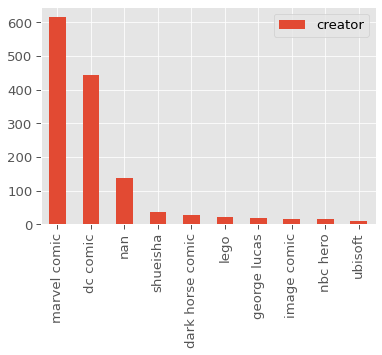

In [1166]:
dist_plot('creator')

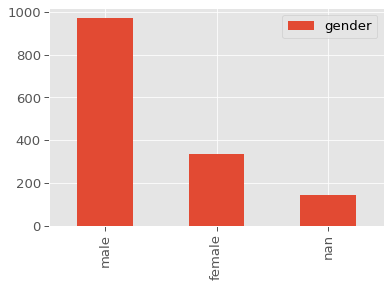

In [1167]:
dist_plot('gender')

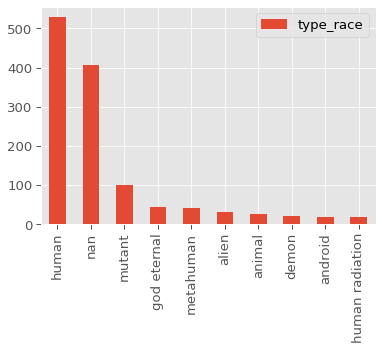

In [1168]:
col = 'type_race'
dist_plot(col)

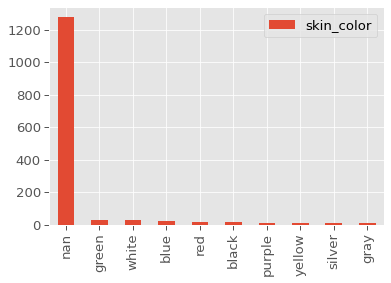

In [1169]:
col = 'skin_color'
dist_plot(col)

In [1170]:
# pd.set_option('display.max_colwidth', None)
print("number of values with '∞' as overall_score",sum(data['overall_score']=='∞'))
print("number of values with '-' as overall_score",sum(data['overall_score']=='-'))

number of values with '∞' as overall_score 18
number of values with '-' as overall_score 107


In [1171]:
print('max value',data['overall_score'].max())
print('min value',data['overall_score'].min())
# data['overall_score'].nlargest(2)

max value ∞
min value -


* replace max value with max integer 
* drop the rows with value '-' : we dont know what values they are 

In [1172]:
# data['overall_score'=='-'].count()
# print('count of missing overall score :',data['overall_score'].value_counts()['-'])

In [1173]:
clean_data=data[data['overall_score']!='-']
clean_data=clean_data[clean_data['overall_score']!='∞']
clean_data=clean_data[clean_data['overall_score'].notnull()]

In [1174]:
clean_data.shape

(1325, 81)

* Most common super power

In [1175]:
superpowers = data.loc[:, data.columns.str.startswith('has')].dropna()
superpowers.columns = superpowers.columns.str.replace(r'has_', '')
superpowers = superpowers.T.reset_index()
superpowers['Total'] = superpowers.sum(axis=1)
superpowers = superpowers.sort_values('Total',ascending=False)
superpowers.head(1)

,index,0,1,2,3,4,5,6,7,8,...,1440,1441,1442,1444,1445,1446,1447,1448,1449,Total
48,agility,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,...,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,778.0


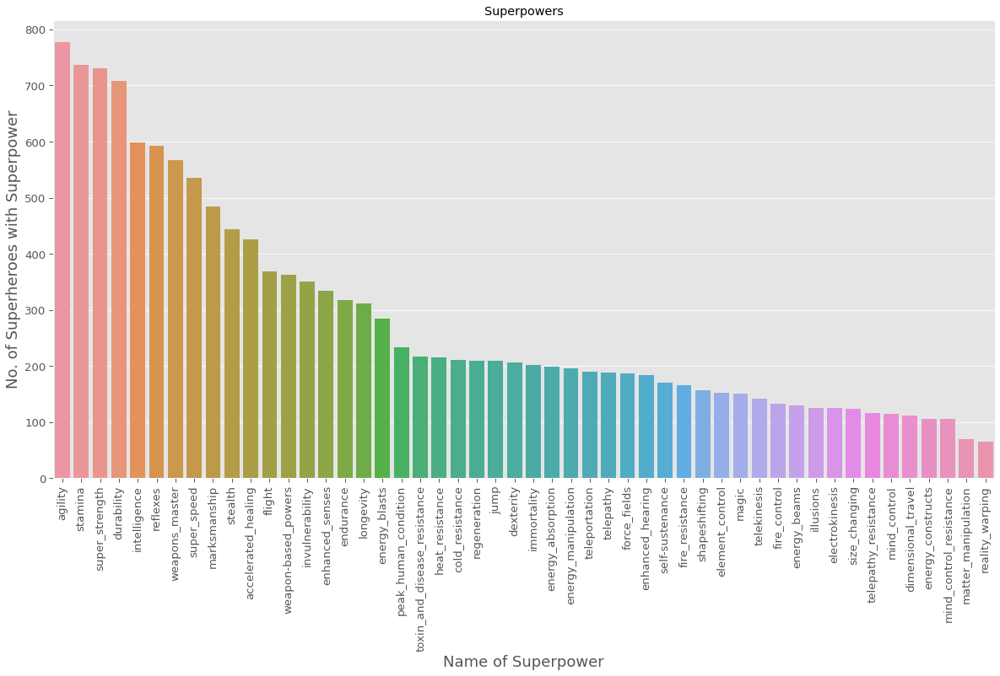

In [1176]:
plt.style.use('ggplot') # Using ggplot2 style visuals

fig, ax = plt.subplots()

fig.set_size_inches(20, 10)

sns.set_context("paper", font_scale=1.5)
f=sns.barplot(x=superpowers['index'], y=superpowers['Total'], data=superpowers)
f.set_xlabel("Name of Superpower",fontsize=18)
f.set_ylabel("No. of Superheroes with Superpower",fontsize=18)
f.set_title('Superpowers')
for item in f.get_xticklabels():
    item.set_rotation(90)

#### 10 Most Common Superpowers ####

1. agility
2. stamina
3. super strength
4. durability
5. intelligence
6. reflexes
7. weapons_master
8. super_speed
9. marksmanship
10. stealth

* Most number of powers

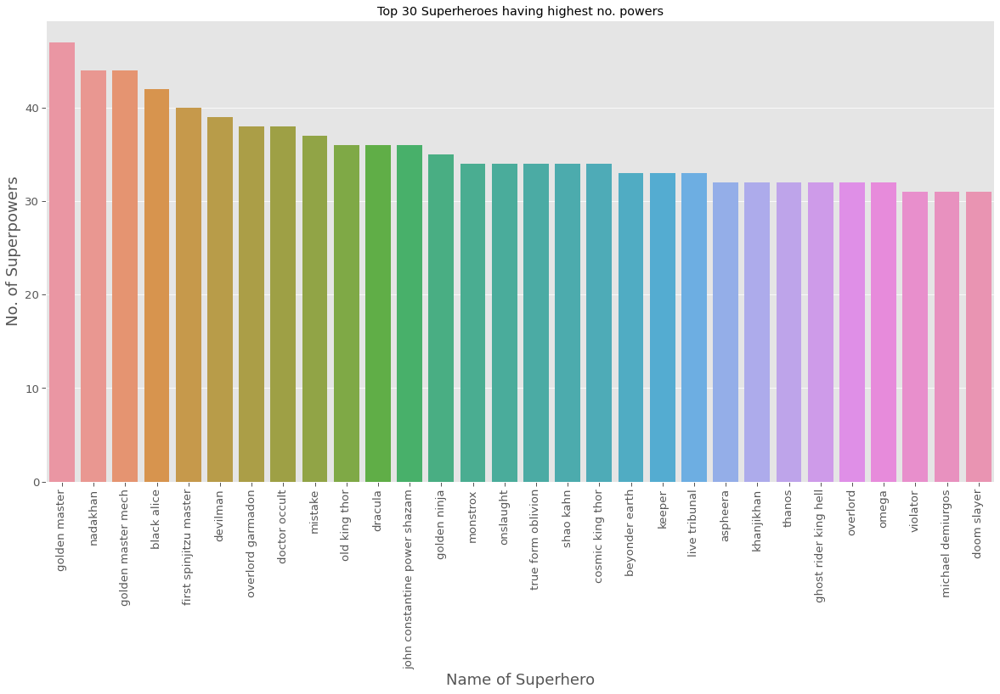

In [1177]:
data_y = data.drop(['overall_score','intelligence_score','strength_score','speed_score','durability_score','power_score','combat_score'],axis=1)
data.loc[:, 'total_superpowers'] = data_y.iloc[:, 1:].sum(axis=1)
data_powers_alignment=data[['name','total_superpowers','alignment','creator']].sort_values('total_superpowers',ascending=False)

plt.style.use('ggplot') # Using ggplot2 style visuals

fig, ax = plt.subplots()

fig.set_size_inches(20, 10)

sns.set_context("paper", font_scale=1.5)
f=sns.barplot(x=data_powers_alignment["name"].head(30), y=data_powers_alignment['total_superpowers'].head(30), data=data_powers_alignment)
f.set_xlabel("Name of Superhero",fontsize=18)
f.set_ylabel("No. of Superpowers",fontsize=18)
f.set_title('Top 30 Superheroes having highest no. powers')
for item in f.get_xticklabels():
    item.set_rotation(90)

In [1178]:
# clean_data['overall_score']

In [1179]:
clean_data.isnull().sum()

name                  0
real_name             0
full_name             0
overall_score         0
history_text          0
                     ..
has_super_speed       9
has_durability        9
has_stamina           9
has_agility           9
has_super_strength    9
Length: 81, dtype: int64

* Convert overall_score to int

In [1180]:
clean_data['overall_score'] = clean_data['overall_score'].astype('int')

In [1181]:
print('second highest value of overall_score: ',np.sort(clean_data['overall_score'].unique())[-2])
print('highest value of overall_score: ', clean_data['overall_score'].max())
print('lowest value of overall_score: ', clean_data['overall_score'].min())

second highest value of overall_score:  229
highest value of overall_score:  237
lowest value of overall_score:  1


In [1182]:
# temp = np.sort(temp)
# temp[0]

* Second highest score = 237
* set the highest score = 300

In [1183]:
# clean_data.loc[clean_data["overall_score"] == 92233, "overall_score"] = 300

In [1184]:
number_cols = clean_data.select_dtypes(include='number').head()
print("Number Columns:\n",number_cols.columns)

Number Columns:
 Index(['overall_score', 'intelligence_score', 'strength_score', 'speed_score',
       'durability_score', 'power_score', 'combat_score', 'has_electrokinesis',
       'has_energy_constructs', 'has_mind_control_resistance',
       'has_matter_manipulation', 'has_telepathy_resistance',
       'has_mind_control', 'has_enhanced_hearing', 'has_dimensional_travel',
       'has_element_control', 'has_size_changing', 'has_fire_resistance',
       'has_fire_control', 'has_dexterity', 'has_reality_warping',
       'has_illusions', 'has_energy_beams', 'has_peak_human_condition',
       'has_shapeshifting', 'has_heat_resistance', 'has_jump',
       'has_self-sustenance', 'has_energy_absorption', 'has_cold_resistance',
       'has_magic', 'has_telekinesis', 'has_toxin_and_disease_resistance',
       'has_telepathy', 'has_regeneration', 'has_immortality',
       'has_teleportation', 'has_force_fields', 'has_energy_manipulation',
       'has_endurance', 'has_longevity', 'has_weapon-ba

In [1185]:
clean_data = clean_data[number_cols.columns]

In [1186]:
clean_data.isnull().sum()

overall_score                       0
intelligence_score                  0
strength_score                      0
speed_score                         0
durability_score                    0
power_score                         0
combat_score                        0
has_electrokinesis                  9
has_energy_constructs               9
has_mind_control_resistance         9
has_matter_manipulation             9
has_telepathy_resistance            9
has_mind_control                    9
has_enhanced_hearing                9
has_dimensional_travel              9
has_element_control                 9
has_size_changing                   9
has_fire_resistance                 9
has_fire_control                    9
has_dexterity                       9
has_reality_warping                 9
has_illusions                       9
has_energy_beams                    9
has_peak_human_condition            9
has_shapeshifting                   9
has_heat_resistance                 9
has_jump    

* We observe a list of consistent 9 null rows 
* Exploring those

In [1187]:
# clean_data['as_electrokinesis'].isnull()
null_mask=clean_data.isnull().any(axis=1)
null_rows = clean_data[null_mask]
null_rows

,overall_score,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,has_electrokinesis,has_energy_constructs,has_mind_control_resistance,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
37,5,80,10,15,10,5,55,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
261,2,40,10,60,45,40,80,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
303,6,90,10,15,10,5,40,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
495,3,70,10,0,0,0,10,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
657,7,95,10,10,10,5,5,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
752,6,90,20,25,40,15,70,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
994,1,45,10,20,50,5,5,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1114,5,80,10,20,10,15,80,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1427,2,60,10,10,0,0,55,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


* Same 9 rows null always , we can drop it

In [1188]:
clean_data=clean_data[clean_data['has_electrokinesis'].notnull()]

In [1189]:
clean_data.isnull().sum()

overall_score                       0
intelligence_score                  0
strength_score                      0
speed_score                         0
durability_score                    0
power_score                         0
combat_score                        0
has_electrokinesis                  0
has_energy_constructs               0
has_mind_control_resistance         0
has_matter_manipulation             0
has_telepathy_resistance            0
has_mind_control                    0
has_enhanced_hearing                0
has_dimensional_travel              0
has_element_control                 0
has_size_changing                   0
has_fire_resistance                 0
has_fire_control                    0
has_dexterity                       0
has_reality_warping                 0
has_illusions                       0
has_energy_beams                    0
has_peak_human_condition            0
has_shapeshifting                   0
has_heat_resistance                 0
has_jump    

In [1190]:
# clean_data.info()

* outlier removal 

In [1191]:

def outlier_remover(df,col):
    Q1 = np.percentile(df[col], 25, method='midpoint')
    Q3 = np.percentile(df[col], 75, method='midpoint')
    IQR = Q3 - Q1
    upper = Q3 +1.5*IQR
    lower = Q1 - 1.5*IQR
    df = df[(df[col]>=lower) & (df[col]<=upper)]
    return df

In [1192]:
# clean_data[(clean_data['intelligence_score']>=100) & (clean_data['intelligence_score']<=130)]

In [1193]:
number_cols = clean_data.select_dtypes(include='int').head()
print("Number Columns:\n",number_cols.columns)

Number Columns:
 Index(['overall_score', 'intelligence_score', 'strength_score', 'speed_score',
       'durability_score', 'power_score', 'combat_score'],
      dtype='object')


In [1194]:
clean_data.shape

(1316, 57)

In [1195]:
for col in number_cols.columns:
    clean_data = outlier_remover(clean_data,col)

In [1196]:
clean_data.shape

(1169, 57)

In [1197]:
ProfileReport(clean_data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [1198]:
cols = list(clean_data.columns)
cols.remove('overall_score')

In [1199]:
number_cols_scale=list(number_cols)
number_cols_scale.remove('overall_score')

In [1200]:
y = clean_data['overall_score']
X = clean_data[cols]

In [1201]:
scaler = StandardScaler()
# scaler.fit(X_train[number_cols])
# X[number_cols_scale] = pd.DataFrame(scaler.transform(X[number_cols]), columns = number_cols)

X[number_cols_scale] = scaler.fit_transform(X[number_cols_scale])

# X_test = pd.DataFrame(scaler.transform(X_test), columns = X_test.columns)

In [1202]:
X

,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,has_electrokinesis,has_energy_constructs,has_mind_control_resistance,has_matter_manipulation,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,-0.063125,-0.259452,0.545997,0.096876,-1.012837,-0.158800,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,1.422643,-0.582627,-0.675964,-0.276264,-1.186853,1.173524,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,-0.558381,2.002773,1.360638,1.589437,1.075357,0.285308,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0
3,-0.558381,0.386898,0.342337,-0.462834,1.075357,-0.824962,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-0.558381,-0.905803,-0.879624,-0.649405,-1.360869,-1.047016,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1444,1.422643,-0.097865,0.138677,0.096876,1.075357,1.173524,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0
1445,0.432131,-0.905803,-0.879624,-1.022545,1.075357,-0.824962,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1446,-0.558381,2.002773,2.175279,1.589437,1.075357,0.285308,0.0,0.0,0.0,1.0,...,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
1447,0.927387,0.386898,2.175279,0.656587,1.075357,0.285308,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [1203]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=108)

In [1204]:
X_train.shape,X_test.shape,y_train.shape,y_test.shape

((818, 56), (351, 56), (818,), (351,))

In [1205]:
# Adding a constant column to our X_train dataframe
X_mod = sm.add_constant(X_train)

# create a first fitted model
linear_model_1 = sm.OLS(y_train,X_mod).fit()

In [1206]:
print(linear_model_1.summary())

                            OLS Regression Results                            
Dep. Variable:          overall_score   R-squared:                       0.846
Model:                            OLS   Adj. R-squared:                  0.835
Method:                 Least Squares   F-statistic:                     74.64
Date:                Tue, 26 Sep 2023   Prob (F-statistic):          9.31e-270
Time:                        06:43:09   Log-Likelihood:                -1669.7
No. Observations:                 818   AIC:                             3453.
Df Residuals:                     761   BIC:                             3722.
Df Model:                          56                                         
Covariance Type:            nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const   

In [1207]:
results_summary = linear_model_1.summary()

In [1208]:
ols_summary=pd.DataFrame(results_summary.tables[1].data)
ols_summary=ols_summary.drop(index=0)
ols_summary.columns=["column_name","coeff","std err", "t" ,"p" , "0.025" , "0.975"]

In [1209]:
ols_summary.head(2)

,column_name,coeff,std err,t,p,0.025,0.975
1,const,7.3822,0.195,37.917,0.000,7.000,7.764
2,intelligence_score,1.8214,0.085,21.437,0.000,1.655,1.988


In [1210]:
ols_summary.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57 entries, 1 to 57
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   column_name  57 non-null     object
 1   coeff        57 non-null     object
 2   std err      57 non-null     object
 3   t            57 non-null     object
 4   p            57 non-null     object
 5   0.025        57 non-null     object
 6   0.975        57 non-null     object
dtypes: object(7)
memory usage: 3.2+ KB


In [1211]:
num_col = ["coeff","std err", "t" ,"p" , "0.025" , "0.975"]
ols_summary[num_col]=ols_summary[num_col].apply(pd.to_numeric)

In [1212]:
ols_summary = ols_summary[ols_summary['p']<0.05]

In [1213]:
ols_summary.sort_values(by=['coeff'], ascending=False)

,column_name,coeff,std err,t,p,0.025,0.975
1,const,7.3822,0.195,37.917,0.000,7.000,7.764
36,has_immortality,3.4241,0.296,11.571,0.000,2.843,4.005
11,has_matter_manipulation,2.5903,0.655,3.953,0.000,1.304,3.877
2,intelligence_score,1.8214,0.085,21.437,0.000,1.655,1.988
13,has_mind_control,1.5616,0.371,4.205,0.000,0.833,2.291
37,has_teleportation,1.5106,0.288,5.248,0.000,0.946,2.076
35,has_regeneration,1.4963,0.258,5.794,0.000,0.989,2.003
15,has_dimensional_travel,1.4241,0.370,3.849,0.000,0.698,2.151
31,has_magic,1.3427,0.302,4.439,0.000,0.749,1.937
49,has_accelerated_healing,1.2516,0.202,6.209,0.000,0.856,1.647


In [1214]:
req_cols = list(ols_summary['column_name'])
req_cols.remove('const')

In [1215]:
X_train = X_train[req_cols]
X_test = X_test[req_cols]

* Checking for VIF 

In [1216]:
vif_data = pd.DataFrame()
vif_data["feature"] = X_train.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X_train.values, i)
                          for i in range(len(X_train.columns))]
  
vif_data[vif_data['VIF']>5]

,feature,VIF


* No column to drop 
#### Base model

In [1217]:
def plot_result(y_pred,y_test):
    # Actual values vs Predicted values graph 
    
    plt.figure(figsize=(18,7))
    count = [i for i in range(0,len(y_pred),1)]
    plt.plot(count,y_test,c='blue',linewidth=2.5,linestyle='-',label='Actual Values')  # taking y_test (Actual) to plot
    plt.plot(count,y_pred,c='red',linewidth=2.5,linestyle='-',label='Predicted Values') # taking y_pred to compare with y_test (Predicted) to plot

    # Plot heading
    plt.legend(loc=0)
    plt.title('Actual vs Predicted Values',fontsize=20)
    plt.xlabel('Index',fontsize=18)
    plt.ylabel('Overall Score',fontsize=18)

    plt.show()

In [1218]:
def scores(y_test,y_pred):
	mse=mean_squared_error(y_test,y_pred)
	mae=mean_absolute_error(y_test,y_pred)
	rmse=np.sqrt(mse)
	print('mse :',mse)
	print('mae :',mae)
	print('rmse :',rmse)

In [1219]:
y_test.shape

(351,)

In [1220]:
def model(model , X_train ,y_train,y_test):
    model.fit(X_train,y_train)
    y_pred=model.predict(X_test)
    print(y_pred.shape)
    plot_result(y_pred,y_test)
    validation_score=cross_val_score(model,X_train,y_train,scoring='neg_mean_squared_error',cv=3)
    val = np.mean(validation_score)
    print('cross_val_score :',val)
    scores(y_test,y_pred)

In [1221]:
regression=LinearRegression()

(351,)


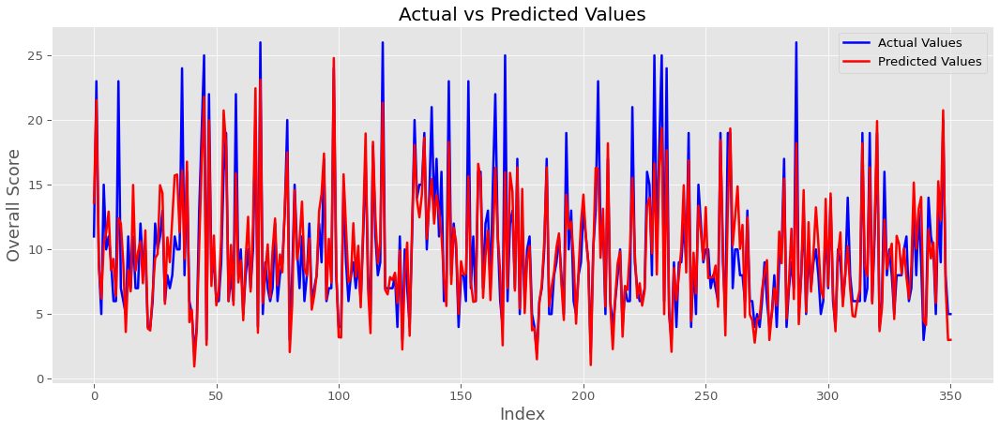

cross_val_score : -4.291615442282995
mse : 5.399650587621573
mae : 1.6378420876753936
rmse : 2.323714824934758


In [1222]:
model(regression , X_train ,y_train,y_test)

* Overall performance of the model is satisfactory 
* We will use the basemodel itself for now

## Predicting score for the data where overall_score is missing
### prediction for overall_score = '∞'

In [1223]:
infinity_data=data[data['overall_score']=='∞']
# Standard scaling 
infinity_data[number_cols_scale] = scaler.transform(infinity_data[number_cols_scale])
new_req_cols = copy.deepcopy(req_cols)
new_req_cols.append('name')
infinity_data = infinity_data[new_req_cols]
# clean_data=clean_data[clean_data['overall_score']!='∞']

In [1224]:
over_score = regression.predict(infinity_data[req_cols])

In [1225]:
# infinity_data[number_cols_scale] = scaler.transform(infinity_data[number_cols_scale])
# over_score

In [1226]:
temp = pd.DataFrame(over_score)
temp.columns=['overall_score']
# temp

In [1227]:
# temp

In [1228]:
# infinity_data.append(temp, ignore_index=True)
# df_concat = pd.concat([df1.reset_index(drop=True), df2.reset_index(drop=True)], axis=1)
concatenated_df = pd.concat([infinity_data['name'].reset_index(drop=True), 
                             temp['overall_score'].reset_index(drop=True)],
                            axis=1)

In [1229]:
concatenated_df = concatenated_df.sort_values(by=['overall_score'], ascending=False)
concatenated_df.head(5)

,name,overall_score
6,golden master mech,39.412689
14,golden master,39.315131
2,black alice,37.710292
17,true form oblivion,37.678308
9,live tribunal,37.294927


### prediction for overall_score = '-'

In [1230]:
un_data=data[data['overall_score']=='-']
# Standard scaling 
un_data[number_cols_scale] = scaler.transform(un_data[number_cols_scale])
new_req_cols = copy.deepcopy(req_cols)
new_req_cols.append('name')
un_data = un_data[new_req_cols]
# over_score = regression.predict(infinity_data[req_cols])
# over_score

In [1231]:
# un_data.isnull().sum()

In [1232]:
un_data=un_data[un_data['has_super_strength'].notnull()]
# un_data.isnull().sum()

In [1233]:
un_score = regression.predict(un_data[req_cols])
# un_score

In [1234]:
# def table_prepare(infinity_data,number_cols_scale,req_cols,reference_col):
#     infinity_data[number_cols_scale] = scaler.transform(infinity_data[number_cols_scale])
#     new_req_cols = copy.deepcopy(req_cols)
#     new_req_cols.append(reference_col)
#     new_req_cols.append('name')
#     infinity_data = infinity_data[new_req_cols]
#     infinity_data=infinity_data[infinity_data['has_super_strength'].notnull()]
#     return infinity_data

def table_prepare(infinity_data,number_cols_scale,req_cols,reference_col,model):
    infinity_data[number_cols_scale] = scaler.transform(infinity_data[number_cols_scale])
    new_req_cols = copy.deepcopy(req_cols)
    new_req_cols.append(reference_col)
    new_req_cols.append('name')
    infinity_data = infinity_data[new_req_cols]
    infinity_data=infinity_data[infinity_data['has_super_strength'].notnull()]
    over_score = model.predict(infinity_data[req_cols])
    temp = pd.DataFrame(over_score)
    temp.columns=['overall_score']
    concatenated_df = pd.concat([infinity_data[['name',reference_col]].reset_index(drop=True), 
                             temp['overall_score'].reset_index(drop=True)],axis=1)

    return concatenated_df

In [1235]:
print('number_cols_scale :',number_cols_scale)
print('req_cols :',req_cols)
# print('reference_col',reference_col)

number_cols_scale : ['intelligence_score', 'strength_score', 'speed_score', 'durability_score', 'power_score', 'combat_score']
req_cols : ['intelligence_score', 'strength_score', 'speed_score', 'has_electrokinesis', 'has_mind_control_resistance', 'has_matter_manipulation', 'has_mind_control', 'has_dimensional_travel', 'has_size_changing', 'has_jump', 'has_self-sustenance', 'has_cold_resistance', 'has_magic', 'has_telekinesis', 'has_regeneration', 'has_immortality', 'has_teleportation', 'has_force_fields', 'has_endurance', 'has_energy_blasts', 'has_invulnerability', 'has_accelerated_healing', 'has_intelligence', 'has_super_speed', 'has_durability', 'has_super_strength']


## Question 1

<b>1)	How would you define most powerful superhero from the information available in dataset? <br/>
      a>	Who is the most powerful superhero from each creator?</b>


* The field provided in the data set 'overall_score' is a good estimate of the power of the superhero.
* However, the challenge is that there are :
 > 18 incidents with '∞' as overall_score <br/>
 > 107 incidents with '-' as overall_score <br/>
* To overcome this challenge we built a linear rgressor model to predict the score given the features
* Then we predict the score for 
> 18 incidents with '∞' as overall_score <br/>
> 107 incidents with '-' as overall_score <br/>
* Who ever gets the maximum score is the strongest superhero

<i>Note : More sophisticated model than linear regressor can be used.However, to provide an intution of the solution we stuck to the base model. </i>

### > Who is the most powerful superhero from each creator ?
* Top 10 creator details provided 
* Incidents for which creator information is not provided is grouped as nan

In [1236]:
reference_col = 'creator'
# regression
res = table_prepare(data,number_cols_scale,req_cols,reference_col,regression)

In [1237]:
des_op =res.sort_values(['overall_score'], ascending=False).groupby('creator').head(1)
des_op[['name','creator']].head(10)

,name,creator
508,golden master mech,nan
173,black alice,dc comic
1285,true form oblivion,marvel comic
381,devilman,shueisha
408,dracula,konami
1294,unicron,hasbro
509,golden ninja,lego
818,man miracle,image comic
1141,skeletor,mattel
776,link,nintendo


In [1238]:
# 

### Question 2
2)	Find the top 5 superpowers in descending order.

* Intution
> We observe the contribution of various powers to the 'overall_score' field.<br/>
> Larger the positive coefficient greater the contribution.<br/>
> Hence sorting and picking top 5 gives the result.<br/>

In [1239]:
top_5 = ols_summary.sort_values(['coeff'], ascending=False)
top_5=top_5.iloc[1: , :]
top_5[['column_name','coeff']].head(5)

,column_name,coeff
36,has_immortality,3.4241
11,has_matter_manipulation,2.5903
2,intelligence_score,1.8214
13,has_mind_control,1.5616
37,has_teleportation,1.5106


### Question 3
<b>	Which race has the most immortal superheroes?</b>
>nan = undefined group

In [1240]:
immortals = data[data['has_immortality']==1]
immortals['type_race'].value_counts().head(5)

nan            38
god eternal    36
human          29
demon          18
new god        11
Name: type_race, dtype: int64

### Question 4
<b>4)Name the creator having most superheroes of type “Parademon”.</b>

In [1241]:
data[data['type_race']=='parademon']['creator']

991    dc comic
Name: creator, dtype: object

### Question 5
*	Which comic creator has most superhero teams?<br/>
 a.	Find names, real names and alias of superhero who is part of most teams.<br/>
 b.	Are there any crossovers between creators and teams?


In [1242]:
# temp

In [1243]:
creator_team=data[data['teams']!='[]'][['creator','teams','name','real_name','aliases']]
# creator_team['creator'].value_counts()

In [1244]:
creator_team.head()

,creator,teams,name,real_name,aliases
0,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",man,delroy garrett jr,
2,marvel comic,"['Teen Brigade', 'Ultimate Fantastic Four', 'U...",abomb,richard milhouse jones,rick jones
3,dc comic,"['Blue Lantern Corps', 'Green Lantern Corps', ...",aa,aa,
5,george lucas,['Jedi Order'],aayla secura,aayla secura,
6,dark horse comic,['Bureau for Paranormal Research and Defense'],abe sapien,abraham sapien,langdon everett caul abraham sapien langdon caul


In [1245]:
df1 = creator_team.groupby('creator')['teams'].apply(' '.join).reset_index()

In [1246]:
df1.head(2)

,creator,teams
0,cartoon network,['Flex Fighters']
1,dark horse comic,['Bureau for Paranormal Research and Defense']...


In [1247]:
# df1
# direct=direct.assign(country=direct['country'].str.split(',')).explode('country')

In [1248]:
pattern = '(\[\')[a-zA-Z0-9 +]+(\'\])'
sub1="['"
sub2="']"
import re
def length_count(x, denote = 'creator'):        
    text = ''.join(x)
    text = text.lower()
#     print(">",text)
    test_str = text.replace("'] ['",",# ")
#     test_str = text.replace('"',"'")
#     print('>',test_str)
    # getting index of substrings
    idx1=0
    id2 =0
    try:
        idx1 = test_str.index(sub1)
    except:
        subk='["'
        idx1 = test_str.index(subk)
    try:
        idx2 = test_str.index(sub2)
    except :
        subl='"]'
        idx2 = test_str.index(subl)
    res = test_str[idx1 + len(sub1) : idx2]
    res_str = res.replace("',",",# ")
    
#     print('>',res_str)
    s = re.sub(r"[^a-zA-Z0-9,#']+", ' ', res_str)
#     print('>',s)
    final_string = []
    temp_store = re.split(',#', s)
#     print('>',temp_store)
    for i in temp_store:
        i = i.strip()
        i = i.replace("'","")
        if i not in final_string:
#             i = i.strip()
            final_string.append(i)
#     print('>',final_string)
    length = len(final_string)
#     print('>',final_string)
    new_final_string = ', '.join(final_string)
    
#     text = res.split(',#')

#     print('>',new_final_string)
    return length
#     return len(x)


In [1249]:
df1['team_count']=df1['teams'].apply(length_count)
# df.keywords.str.len()
# apply(function)

* Which comic creator has most superhero teams?<br/>

In [1250]:
df1.sort_values('team_count',ascending=False).head(2)

,creator,teams,team_count
2,dc comic,"['Blue Lantern Corps', 'Green Lantern Corps', ...",73
8,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",56


In [1251]:
df2 = creator_team.groupby('name')['teams'].apply(' '.join).reset_index()

In [1252]:
df2=df2[df2['name']!='']
df2.head()

,name,teams
1,aa,"['Blue Lantern Corps', 'Green Lantern Corps', ..."
2,aayla secura,['Jedi Order']
3,abe sapien,['Bureau for Paranormal Research and Defense']
4,abin sur,"['Legion of Super-Heroes', 'Green Lantern Corps']"
5,abomb,"['Teen Brigade', 'Ultimate Fantastic Four', 'U..."


In [1253]:
# def length_count_df2(text):
#     text = ''.join(text)
#     text = text.lower()
#     sub1="['"
# #     idx1 = text.index(sub1)
#     print('>',text)
#     return 1

In [1254]:
df2['team_count']=df2['teams'].apply(length_count)

In [1255]:
# df2.head()

In [1256]:
df2.sort_values('team_count',ascending=False).head(5)

,name,teams,team_count
142,deadpool,"['Deadpool Corps', 'Agency X', 'X-Force', 'Dee...",14
530,wolverine,"['X-Force', 'X-Men', 'Weapon X', 'Secret Defen...",14
229,hulk,"['The Mighty Avengers', 'Agency X', 'Contingen...",12
307,luke cage,"['Mighty Avengers', 'New Avengers', 'Defenders...",10
152,doctor strange classic,"['Defenders', 'Neo-Knights', 'The Mighty Aveng...",10


### Find names, real names and alias of superhero who is part of most teams.<br/>

In [1257]:
data[(data['name']=='deadpool') | (data['name']=='wolverine')][['name','real_name','aliases']]
# ['name','real_name','aliases']

,name,real_name,aliases
370,deadpool,wade wilson,wade wilson jack chiyonosake wolf rice wine rh...
1415,wolverine,logan,weapon x weapon ten death mutate jim logan emi...


In [1258]:
pattern = '(\[\')[a-zA-Z0-9 +]+(\'\])'
sub1="['"
sub2="']"
import re
def clean_team(x, denote = 'creator'):        
    text = ''.join(x)
    text = text.lower()
#     print(">",text)
    test_str = text.replace("'] ['",",# ")
#     test_str = text.replace('"',"'")
#     print('>',test_str)
    # getting index of substrings
    idx1=0
    id2 =0
    try:
        idx1 = test_str.index(sub1)
    except:
        subk='["'
        idx1 = test_str.index(subk)
    try:
        idx2 = test_str.index(sub2)
    except :
        subl='"]'
        idx2 = test_str.index(subl)
    res = test_str[idx1 + len(sub1) : idx2]
    res_str = res.replace("',",",# ")
    
#     print('>',res_str)
    s = re.sub(r"[^a-zA-Z0-9,#']+", ' ', res_str)
#     print('>',s)
    final_string = []
    temp_store = re.split(',#', s)
#     print('>',temp_store)
    for i in temp_store:
        i = i.strip()
        i = i.replace("'","")
        if i not in final_string:
#             i = i.strip()
            final_string.append(i)
#     print('>',final_string)
    length = len(final_string)
#     print('>',final_string)
    new_final_string = ', '.join(final_string)
    
#     text = res.split(',#')

#     print('>',new_final_string)
    return new_final_string

In [1259]:
check_overlap = creator_team[['creator','teams']]

In [1260]:
check_overlap['clean_team']=check_overlap['teams'].apply(clean_team)

In [1261]:
check_overlap.head()

,creator,teams,clean_team
0,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...","annihilators, asgardians, avengers, new avengers"
2,marvel comic,"['Teen Brigade', 'Ultimate Fantastic Four', 'U...","teen brigade, ultimate fantastic four, u men, ..."
3,dc comic,"['Blue Lantern Corps', 'Green Lantern Corps', ...","blue lantern corps, green lantern corps, justi..."
5,george lucas,['Jedi Order'],jedi order
6,dark horse comic,['Bureau for Paranormal Research and Defense'],bureau for paranormal research and defense


In [1262]:
check_overlap_split=check_overlap.assign(clean_team=check_overlap['clean_team'].str.split(',')).explode('clean_team')
# direct=direct.assign(director=direct['director'].str.split(',')).explode('director')

In [1263]:
check_overlap_split.head()

,creator,teams,clean_team
0,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",annihilators
0,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",asgardians
0,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",avengers
0,marvel comic,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",new avengers
2,marvel comic,"['Teen Brigade', 'Ultimate Fantastic Four', 'U...",teen brigade


In [1264]:
agg_by_team = check_overlap_split.groupby('clean_team')['creator'].apply(','.join).reset_index()

In [1265]:
def creator_count(text):
    text = ''.join(text)
#     text = text.lower()
    creators = text.split(',')
    inter_m_list = list(set(creators))
    length = len(inter_m_list)
    if 'nan' in inter_m_list and length>1:
        inter_m_list.remove('nan')
        length-=1
#     print('>',set(creators))
    return length
    

In [1266]:
def clean_creator(text):
    text = ''.join(text)
#     text = text.lower()
    creators = text.split(',')
    inter_m_list = list(set(creators))
    length = len(inter_m_list)
    if 'nan' in inter_m_list and length>1:
        inter_m_list.remove('nan')
        length-=1
    clean = ' ,'.join(inter_m_list)
    return clean

In [1267]:
agg_by_team.head()

,clean_team,creator
0,a force,"marvel comic,marvel comic,marvel comic,marvel ..."
1,a i m,"marvel comic,marvel comic,marvel comic"
2,a r m o r,"marvel comic,marvel comic,marvel comic,marvel ..."
3,acolytes,"marvel comic,marvel comic"
4,agency x,"marvel comic,marvel comic,marvel comic,marvel ..."


In [1268]:
agg_by_team['creator_count']=agg_by_team['creator'].apply(creator_count)
agg_by_team['clean_creator']=agg_by_team['creator'].apply(clean_creator)

In [1269]:
agg_by_team.head()

,clean_team,creator,creator_count,clean_creator
0,a force,"marvel comic,marvel comic,marvel comic,marvel ...",1,marvel comic
1,a i m,"marvel comic,marvel comic,marvel comic",1,marvel comic
2,a r m o r,"marvel comic,marvel comic,marvel comic,marvel ...",1,marvel comic
3,acolytes,"marvel comic,marvel comic",1,marvel comic
4,agency x,"marvel comic,marvel comic,marvel comic,marvel ...",1,marvel comic


 ### b.	Are there any crossovers between creators and teams?</b>
 > yes 

In [1270]:
agg_by_team.sort_values('creator_count',ascending=False).head(5)[['clean_team','creator_count','clean_creator']]

,clean_team,creator_count,clean_creator
289,incredible family,2,"disney ,dark horse comic"
186,titans,2,"marvel comic ,dc comic"
0,a force,1,marvel comic
257,demon knights,1,dc comic
266,female furies,1,dc comic


### Question 6
* What are the characteristics that can predict a superhero alignment.

In [1271]:
alignment=data[data['alignment']=='good']
alignment=alignment[alignment['has_agility'].notnull()]
alignment=alignment[(alignment['overall_score']!='-') & (alignment['overall_score']!='∞')]
alignment['overall_score'] = alignment['overall_score'].astype(int)
alignment.isnull().sum()

name                  0
real_name             0
full_name             0
overall_score         0
history_text          0
                     ..
has_durability        0
has_stamina           0
has_agility           0
has_super_strength    0
total_superpowers     0
Length: 82, dtype: int64

In [1272]:
ProfileReport(alignment[alignment['alignment']=='good'])

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [1273]:
alignment=data[data['alignment']=='bad']
alignment=alignment[alignment['has_agility'].notnull()]
alignment=alignment[(alignment['overall_score']!='-') & (alignment['overall_score']!='∞')]
alignment['overall_score'] = alignment['overall_score'].astype(int)
alignment.isnull().sum()
ProfileReport(alignment[alignment['alignment']=='bad'])

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

* What are the characteristics that can predict a superhero alignment.

>The traditional way would be to build a classifier and observe the factord that contribute most to it's success.<br/>
>Considering the time constraint I couldn't follow that approach <br/>
>However by analysis/profiling of data following observations were made :<br/>
1> Superheros with negative alignment have higher strength, speed , durability,power score <br/>
2>Superheros with positive alignment have higher intelligence and combat score <br/>

### Question 7
* 	From history of superheroes, <br/>
    a.	Find list of superheroes having negative past but now aligned positively. <br/>
    (Negativity of past can be decided by multiple methods, please use which is familiar to you) <br/>
    b.	Extract patterns from superhero history for each creator.


In [1274]:
from transformers import pipeline
summarizer = pipeline("summarization", model="stevhliu/my_awesome_billsum_model")
classifier = pipeline("sentiment-analysis", model="stevhliu/my_awesome_model")
warnings.filterwarnings('ignore')
from transformers import logging
# logging.getLogger("pytorch_pretrained_bert.tokenization").setLevel(logging.ERROR)
logging.set_verbosity_error()

In [1275]:
count=0
def past_alignment_check(text):
    global count
    count = count+1
    print("completed ",count," of 795")
    text = ''.join(text)
    res = summarizer(text)
    test_sentence = res[0]['summary_text']
    result = classifier(test_sentence)
    senti = 'good'
    score = 0
    if result[0]['label']== 'LABEL_0':
        senti = 'bad'
#     classifier(test_sentence)

# [{'label': 'LABEL_0', 'score': 0.9466749429702759}]
#     print(text)
    return senti

In [1276]:
# warnings.filterwarnings('ignore')

past=data[(data['history_text']!='') & (data['alignment']=='good')][['name','creator','history_text','alignment']].head(50)
past.shape

(50, 4)

In [1277]:
from pathlib import Path

# create a Path object with the path to the file
path = Path('./predicted.csv')

if path.is_file():
    print("reading pretrained model....")
    past = pd.read_csv('./predicted.csv')
    print('done')
    
else:
    past['past_alignment']=past['history_text'].apply(past_alignment_check)
    past.to_csv('predicted1.csv')

reading pretrained model....
done


In [1278]:
past.head()

,Unnamed: 0,name,creator,history_text,alignment,past_alignment
0,0,man,marvel comic,delroy garrett jr grow become track star compe...,good,bad
1,2,abomb,marvel comic,richard rick jones orphan young age expel seve...,good,bad
2,3,aa,dc comic,aa one passive member pumice people race stone...,good,bad
3,4,aaron cash,dc comic,aaron cash head security arkham asylum hook ha...,good,bad
4,5,aayla secura,george lucas,ayla secura rutian twilek jedi knight onetime ...,good,good


* predicting past_alignment from history_text took too much time <br/>
* Hence, we limited ourself to picking just 50 samples <br/>
###  a.	Find list of superheroes having negative past but now aligned positively

In [1279]:
past[past['past_alignment']=='bad']['name']

0                             man
1                           abomb
2                              aa
3                      aaron cash
5                      abe sapien
6                        abin sur
7                  absorb man mcu
10                   adam strange
12                          agent
13                      agent bob
15    agent coulson destroyer gun
16              agent coulson mcu
17                  agent may mcu
18                     agent zero
19                          akita
22              alfred pennyworth
24               allan quatermain
27                ancient one mcu
28                 ando masahashi
29                     angel dust
30                angel salvadore
31                          angel
32                     animal man
34                      antman ii
36                         antman
37                       aquababy
38                       aquagirl
41              aquaman injustice
45                         ardina
46            

### b.	Extract patterns from superhero history for each creator.

* Creators distribution with superheroes having negative past but now aligned positively

In [1280]:
past[past['past_alignment']=='bad']['creator'].value_counts()

marvel comic        17
dc comic             9
dark horse comic     2
lego                 1
wildstorm            1
nbc hero             1
Name: creator, dtype: int64

* Creators distribution with superheroes having positive past and now aligned positively

In [1281]:
past[past['past_alignment']=='good']['creator'].value_counts()

dc comic         6
marvel comic     5
ubisoft          2
george lucas     1
nbc hero         1
j r r tolkien    1
Name: creator, dtype: int64

### Question 8
*	Report on the 10 superheroes with most relatives, 
* status of those relatives where possible, 
* and the alignment of those superheroes.

In [1282]:
relatives = data[data['name']!=''][['name','relatives','alignment']]

In [1283]:
relatives.head()

,name,relatives,alignment
0,man,NaN,good
1,gotham,Bruce Wayne (genetic template),nan
2,abomb,Marlo Chandler-Jones (wife); Polly (aunt); Mrs...,good
3,aa,NaN,good
4,aaron cash,NaN,good


In [1284]:
def clean_relatives(text):
    text=str(text).strip()
    text = text.replace(';',',')
    if text=='nan':
#         print('hola',end = ' ')
        return "No info available"
#     print('>',text)
    return text

def clean_relatives_count(text):
    text=str(text).strip()
    if text=='No info available':
        return 0
    else :
        list_count = text.split(',')
        length=len(list_count)
#         print('>',list_count)
    return length

In [1285]:
relatives['relatives_cleaned']=relatives['relatives'].apply(clean_relatives)
relatives['relatives_count']=relatives['relatives_cleaned'].apply(clean_relatives_count)

In [1286]:
relatives.head()

,name,relatives,alignment,relatives_cleaned,relatives_count
0,man,NaN,good,No info available,0
1,gotham,Bruce Wayne (genetic template),nan,Bruce Wayne (genetic template),1
2,abomb,Marlo Chandler-Jones (wife); Polly (aunt); Mrs...,good,"Marlo Chandler-Jones (wife), Polly (aunt), Mrs...",9
3,aa,NaN,good,No info available,0
4,aaron cash,NaN,good,No info available,0


### Question 8
* Report on the 10 superheroes with most relatives, status of those relatives where possible, and the alignment of those superheroes.

In [1287]:
relatives.sort_values('relatives_count',ascending=False).head(10)[['name','relatives_cleaned','alignment','relatives_count']]

,name,relatives_cleaned,alignment,relatives_count
936,namor,"Elanna (maternal ancestor), Tanas (maternal an...",good,53
574,havok,Oscar Summers (adoptive paternal distant ances...,good,48
75,aquaman,"Koryak (son), Arthur Curry, Jr. (son), A.J. (s...",good,37
1100,robin v,"Talia al Ghul (mother),\nBruce Wayne (Batman, ...",good,36
121,baron zemo,"Harbin Zemo (distant ancestor, deceased),\nHad...",bad,33
515,ghost rider king hell,"Illyana Kale (maternal ancestor, deceased), De...",good,33
1251,supergirl,"Zor-El (father), Allura In-Ze (mother), Jor-El...",good,33
340,cyclops,Oscar Summers (adoptive paternal distant ances...,good,33
1328,toxin,"Carl Brock (father, estranged), Janine Brock (...",good,28
312,colossus,"Grigory Efimovich Rasputin (great-grandfather,...",good,28


### Question 9
*	Find out any other interesting insights from given data. 
* 	Which 3 comic characters can you recommend to your friends to read or watch?


>* Super heros are product of an imaginitive mind with escapist tendencies.<br/>
>* Failing to deal with the reality we resort to imagination of super power or super being to seek comfort in the <br/>
thought that a miracle would set us free.<br/>
>* But miracles rarely do happen and even less to those waiting for it.<br/>
>* Hence, I would recommend watching superheros with the least 'over_all' score.<br/>
>* It doesn't take a lot of courage to stand before the bullet when you know it would bounce off your skin.<br/>
but takes a mighty heart to do so knowing full well that it would pierce through them.<br/>
>* Hence I believe superheros with the least 'over_all' score rank higher when it come to attitude.<br/>
>* Sends the message a sharp blade don't defeat the dragon, but a valiant warrior does.<br/>

>* But knowing my friends how shallow they are they would rather enjoy watching the strongest superheros.
>* Because I care for their happiness I would recommend superheros with the highest 'over_all' score.

In [1288]:
des_op[['name']].head(3)

,name
508,golden master mech
173,black alice
1285,true form oblivion
